## Importing libraries

In [2]:
import collections
import time 
import tqdm
from PIL import Image
from functools import partial
train_on_gpu = True

import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score

import torchvision
import torchvision.transforms as transforms
import torch
from torch.utils.data import TensorDataset, DataLoader,Dataset
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.utils.data.sampler import SubsetRandomSampler
from torch.optim.lr_scheduler import StepLR, ReduceLROnPlateau, CosineAnnealingLR

from catalyst.data import Augmentor

from catalyst.data.reader import ScalarReader, ReaderCompose, LambdaReader
from catalyst.dl.runner import SupervisedRunner
from catalyst.dl.callbacks import DiceCallback, EarlyStoppingCallback, InferCallback, CheckpointCallback

import segmentation_models_pytorch as smp



/home/jager/anaconda3/lib/python3.7/site-packages/tqdm/std.py:658: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel
/home/jager/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject

/home/jager/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject

/home/jager/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject



## Helper functions

In [1]:
from utils.utils import *

'''
get_img -> return image from path

rle_decode -> make mask as 2darray from rle-code

mask2rle -> create rle code from mask

make_mask -> return ndarray (concatenate masks for all classes to one array)

post_process -> in 2 words: apply thresholding to predicted masks

visualize / visualize_with_raw -> plot images and masks

plot_with_augmentation -> plot images with augmentation

'''

def get_training_augmentation():
    train_transform = [
        albu.Resize(640, 640),
        albu.HorizontalFlip(p=0.5),
        albu.ElasticTransform(p=0.6,border_mode=cv2.BORDER_REFLECT_101,alpha_affine=40),
        albu.ShiftScaleRotate(scale_limit=0.5, rotate_limit=90, shift_limit=0.1, p=0.6, border_mode=0),
        albu.RandomBrightnessContrast(
          brightness_limit=0.2, contrast_limit=0.2, p=0.3
          ),
        albu.GridDistortion(p=0.3),
        albu.HueSaturationValue(p=0.3),
        albu.OpticalDistortion(p=0.4, distort_limit=2, shift_limit=0.5),

    ]
    return albu.Compose(train_transform)


def get_validation_augmentation():
    test_transform = [albu.Resize(640, 640)]
    return albu.Compose(test_transform)


def get_preprocessing(preprocessing_fn):

    # Normalizes data depending on selected pretrained CNN 
    _transform = [
        albu.Lambda(image=preprocessing_fn),
        albu.Lambda(image=to_tensor, mask=to_tensor),
    ]
    return albu.Compose(_transform)

/home/jager/anaconda3/lib/python3.7/site-packages/tqdm/std.py:658: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel
/home/jager/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject

/home/jager/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject

/home/jager/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject

/home/jager/anaconda3/lib/python3.7/site-packages/albumentations/pytorch/transforms.py:59: DeprecationWarning:

ToTensor is deprecated and will be replaced by ToTensorV2 in albumen

In [4]:
# Kaggle-style structure: use submission DataFrame with the same columns for a train DataFrame
train = pd.read_pickle('/home/jager/Projects/UAV/dataset-medium/rle_masks.pcl')
sub = pd.DataFrame(columns = train.columns)

In [5]:
train.head()

,ImageID,EncodedPixel,Class,Shape
4,107f24d6e9_F1BE1D4184INSPIRE-ortho-000003.png,,Water,"(1120, 1120, 3)"
5,107f24d6e9_F1BE1D4184INSPIRE-ortho-000003.png,,Buildings,"(1120, 1120, 3)"
6,107f24d6e9_F1BE1D4184INSPIRE-ortho-000003.png,,Car,"(1120, 1120, 3)"
7,107f24d6e9_F1BE1D4184INSPIRE-ortho-000003.png,47929 50 49048 83 50167 102 51285 109 51429 74...,Trees,"(1120, 1120, 3)"
8,107f24d6e9_F1BE1D4184INSPIRE-ortho-000004.png,50419 41 51539 105 52659 130 53779 148 54898 1...,Trees,"(1120, 1120, 3)"


In [6]:
train.Class.unique()

array(['Water', 'Buildings', 'Car', 'Trees'], dtype=object)

### let's get some information about labeled images

In [7]:
area_class_dict = {}
avg_area_dict = {}
for class_ in train.Class.unique():
    help_df = train[(train['Class'] == class_) & (train['EncodedPixel'] != '')]
    area = 0
    for row in help_df.iterrows():
        mask_rle = row[1]['EncodedPixel']
        mask = rle_decode(mask_rle)
        area += np.where(mask == 1)[0].shape[0]
    area_class_dict[class_] = area
    avg_area_dict[class_] = area/help_df.shape[0]

In [8]:
area_class_dict

{'Water': 33166144, 'Buildings': 128993959, 'Car': 8332717, 'Trees': 253195089}

In [9]:
avg_area_dict

{'Water': 86595.67624020888,
 'Buildings': 231587.0,
 'Car': 16180.033009708737,
 'Trees': 225463.124666073}

Text(0.5, 1.0, 'Average mask area')

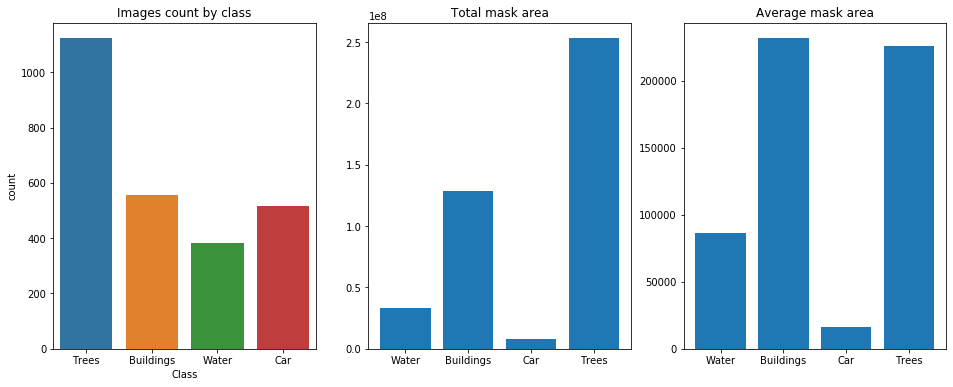

In [10]:
ar_keys = area_class_dict.keys()
ar_values = area_class_dict.values()

avg_ar_keys = avg_area_dict.keys()
avg_ar_values = avg_area_dict.values()

f, axes = plt.subplots(1, 3, figsize=(16, 6))
sns.countplot(x = 'Class', data = train[train['EncodedPixel'] != ''], ax = axes[0]).set_title('Images count by class')
axes[1].bar(ar_keys,ar_values)
axes[1].set_title('Total mask area')
axes[2].bar(avg_ar_keys,avg_ar_values)
axes[2].set_title('Average mask area')

In [6]:
path = '/home/jager/Projects/UAV/dataset-medium'

In [7]:
n_train = len(os.listdir(f'{path}/image_train'))
n_test = len(os.listdir(f'{path}/test'))
print(f'There are {n_train} images in train dataset')
print(f'There are {n_test} images in test dataset')

There are 1386 images in train dataset
There are 15 images in test dataset


In [8]:
train  = train.sort_values(by=['ImageID', 'Class'])

# Look at random sample - image and masks

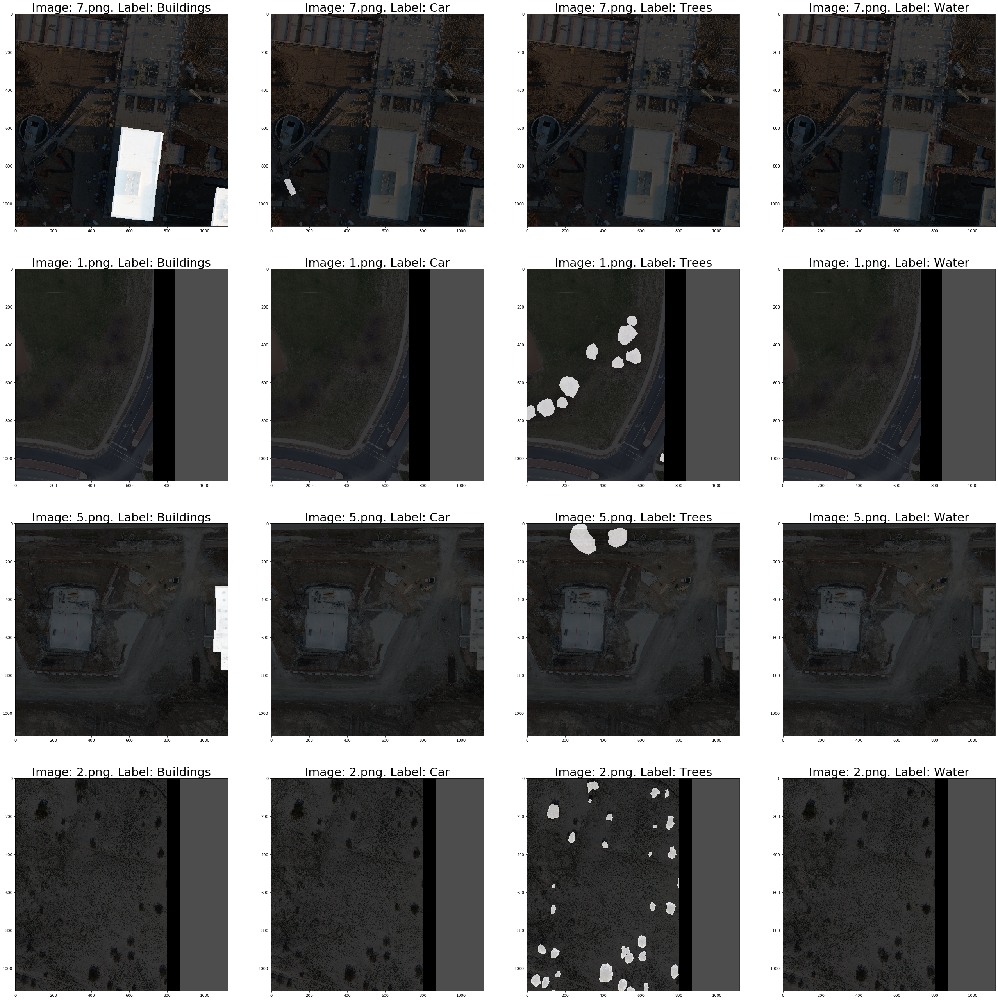

In [91]:
fig = plt.figure(figsize=(45, 70))
for j, im_id in enumerate(np.random.choice(train['ImageID'].unique(), 4)):
    for i, (idx, row) in enumerate(train.loc[train['ImageID'] == im_id].iterrows()):
        ax = fig.add_subplot(6, 4, j * 4 + i + 1)
        im = Image.open(f"{path}/image_train/{row['ImageID']}")
        plt.imshow(im)
        mask_rle = row['EncodedPixel']
        try:
            mask = rle_decode(mask_rle)
        except:
            mask = np.zeros((1120, 1120))
        plt.imshow(mask, alpha=0.7, cmap='gray')
        ax.set_title(f"Image: {row['ImageID'][-5:]}. Label: {row['Class']}", fontsize=30)

## Preparing data

Split images using into train_ids and valid_ids using train_test_split

In [9]:
id_mask_count = train.loc[train['EncodedPixel'].isnull() == False, 'ImageID'].value_counts().reset_index().rename(columns={'index': 'Img_ID'})
train_ids, valid_ids = train_test_split(id_mask_count['Img_ID'].values, random_state=42,test_size = 0.2)

In [10]:
test_ids = np.array(os.listdir('/home/jager/Projects/UAV/dataset-medium/test'))

In [ ]:
# If you use 'sub' DataFrame:
#test_ids = sub['ImageID'].drop_duplicates().values

In [11]:
image_name = '15efe45820_D95DF0B1F4INSPIRE-ortho-000026.png'
image = get_img(image_name, '/home/jager/Projects/UAV/dataset-medium/image_train')
mask = make_mask(train, image_name)

In [7]:
visualize(image, mask)

In [8]:
plot_with_augmentation(image, mask, albu.OpticalDistortion(p=1, distort_limit=2.1, shift_limit=0.5))

## Setting up data for training in Catalyst

In [10]:
path = 'path to dataset'
img_ids = train_ids

In [12]:
class CityDataset(Dataset):
    def __init__(self, df: pd.DataFrame = None, datatype: str = 'train', img_ids: np.array = None,
                 transforms = albu.Compose([ToTensor()]),preprocessing=None):
        self.df = df
        if datatype != 'test':
            self.data_folder = f"{path}/image_train"
        else:
            self.data_folder = f"{path}/test"
        self.img_ids = img_ids
        self.transforms = transforms
        self.preprocessing = preprocessing

    def __getitem__(self, idx):
        image_name = self.img_ids[idx]
        mask = make_mask(self.df, image_name)
        image_path = os.path.join(self.data_folder, image_name)
        
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        augmented = self.transforms(image=img, mask=mask)
        img = augmented['image']
        mask = augmented['mask']
        
        if self.preprocessing:
            preprocessed = self.preprocessing(image=img, mask=mask)
            img = preprocessed['image']
            mask = preprocessed['mask']
        return img, mask

    def __len__(self):
        return len(self.img_ids)

/home/jager/anaconda3/lib/python3.7/site-packages/albumentations/pytorch/transforms.py:59: DeprecationWarning:

ToTensor is deprecated and will be replaced by ToTensorV2 in albumentations 0.5.0



Now we define model and training parameters

In [14]:
import segmentation_models_pytorch as smp

batch_size = 4

model = smp.FPN(encoder_name= 'resnext50_32x4d', encoder_weights = "imagenet", classes=4)

In [15]:
from torch import nn
from catalyst.contrib.nn import DiceLoss, IoULoss

criterion = {
    "dice": DiceLoss(),
    "iou": IoULoss(),
    "bce": nn.BCEWithLogitsLoss()
}

In [16]:
from torch import optim

from catalyst.contrib.nn import RAdam, Lookahead

learning_rate = 0.001
encoder_learning_rate = 0.0004

# Since we use a pre-trained encoder, we will reduce the learning rate on it.
layerwise_params = {"encoder*": dict(lr=encoder_learning_rate, weight_decay=0.00003)}

# This function removes weight_decay for biases and applies our layerwise_params
# And I use interesting optimizer from Catalyst - Lookahead (Read the original paper and understand how good naming is)
model_params = utils.process_model_params(model, layerwise_params=layerwise_params)

base_optimizer = RAdam(model_params, lr=learning_rate, weight_decay=0.0003)
optimizer = Lookahead(base_optimizer)

scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.25, patience=2)

In [17]:
from catalyst.dl import SupervisedRunner

num_epochs = 100
#Path to logs files
logdir = "./logs/segmentation"

device = utils.get_device()
print(f"device: {device}")

runner = SupervisedRunner(device=device, input_key="image", input_target_key="mask")

device: cuda


In [18]:
ENCODER = 'resnext50_32x4d'
ENCODER_WEIGHTS = 'imagenet'
DEVICE = 'cuda'

#This is what i wrote earlier - special method 'get_preprocessing_fn' - 
#normalizes data depending on selected pretrained CNN
preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

In [18]:
num_workers = 0
bs = 4
train_dataset = CityDataset(df=train, datatype='train', img_ids=train_ids, transforms = get_training_augmentation(), preprocessing=get_preprocessing(preprocessing_fn))
valid_dataset = CityDataset(df=train, datatype='valid', img_ids=valid_ids, transforms = get_validation_augmentation(), preprocessing=get_preprocessing(preprocessing_fn))

train_loader = DataLoader(train_dataset, batch_size=bs, shuffle=True, num_workers=num_workers)
valid_loader = DataLoader(valid_dataset, batch_size=bs, shuffle=False, num_workers=num_workers)

loaders = {
    "train": train_loader,
    "valid": valid_loader
}

In [10]:
from catalyst.dl.callbacks import DiceCallback, IouCallback, \
  CriterionCallback, MetricAggregationCallback

callbacks = [
    
    CriterionCallback(
        input_key="mask",
        prefix="loss_dice",
        criterion_key="dice"
    ),
    CriterionCallback(
        input_key="mask",
        prefix="loss_iou",
        criterion_key="iou"
    ),
    CriterionCallback(
        input_key="mask",
        prefix="loss_bce",
        criterion_key="bce"
    ),

    # all criterion to one loss.
    MetricAggregationCallback(
        prefix="loss",
        mode="weighted_sum", 
        metrics={"loss_dice": 1, "loss_iou": 0, "loss_bce": 0.3},
    ),

    # metrics
    DiceCallback(input_key="mask"),
    IouCallback(input_key="mask"),
]

runner.train(
    model=model,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    loaders=loaders,
    callbacks=callbacks,
    logdir=logdir,
    num_epochs=num_epochs,
    main_metric = 'loss',
    minimize_metric=True,
    # prints train logs
    verbose=True,
)

In [11]:
utils.plot_metrics(
    logdir=logdir, 
    metrics=["loss", "dice",, "accuracy01", "auc/_mean", 'lr', '_base/lr']
)

In [19]:
from pathlib import Path

ROOT  = Path('/home/jager/Projects/UAV/dataset-medium/')

test_image_path = ROOT / "test"

In [20]:
test_dataset = CityDataset(df=sub, datatype='test', img_ids=test_ids, transforms = get_validation_augmentation(), preprocessing=get_preprocessing(preprocessing_fn))
test_loader = DataLoader(test_dataset, batch_size=6, shuffle=False, num_workers=0)

In [21]:
TEST_IMAGES = sorted(test_image_path.glob("*.png"))

predictions = runner.predict_loader(
    model=model,
    loader=test_loader,
    resume=f"{logdir}/checkpoints/best.pth",
    verbose=True,
)

print(type(predictions))
print(predictions.shape)

=> loading checkpoint ./logs/segmentation/checkpoints/best.pth
loaded checkpoint ./logs/segmentation/checkpoints/best.pth (global epoch 60, epoch 60, stage train)
1/1 * Epoch (infer): 100% 3/3 [00:00<00:00,  3.75it/s]
<class 'numpy.ndarray'>
(15, 4, 320, 640)


In [27]:
TEST_IMAGES

[PosixPath('/home/jager/Projects/UAV/dataset-medium/test/1d056881e8_29FEA32BC7INSPIRE-ortho-000006.png'),
 PosixPath('/home/jager/Projects/UAV/dataset-medium/test/1d056881e8_29FEA32BC7INSPIRE-ortho-000007.png'),
 PosixPath('/home/jager/Projects/UAV/dataset-medium/test/1d4fbe33f3_F1BE1D4184INSPIRE-ortho-000003.png'),
 PosixPath('/home/jager/Projects/UAV/dataset-medium/test/1d4fbe33f3_F1BE1D4184INSPIRE-ortho-000005.png'),
 PosixPath('/home/jager/Projects/UAV/dataset-medium/test/1d4fbe33f3_F1BE1D4184INSPIRE-ortho-000007.png'),
 PosixPath('/home/jager/Projects/UAV/dataset-medium/test/1d4fbe33f3_F1BE1D4184INSPIRE-ortho-000008.png'),
 PosixPath('/home/jager/Projects/UAV/dataset-medium/test/1d4fbe33f3_F1BE1D4184INSPIRE-ortho-000009.png')]

In [26]:
def visualize_with_raw(image, mask, original_image=None, original_mask=None, raw_image=None, raw_mask=None):

    fontsize = 14
    class_dict = {0: 'Buildings', 1: 'Car', 2: 'Trees', 3: 'Water'}

    f, ax = plt.subplots(1, 5, figsize=(44, 32))
    
    ax[0].imshow(image)
    ax[0].set_title('Transformed image', fontsize=fontsize)


    for i in range(4):
        ax[i + 1].imshow(original_image)
        ax[i + 1].imshow(mask[:, :, i], alpha=0.6)
        ax[i + 1].set_title(f'Predicted mask with processing {class_dict[i]}', fontsize=fontsize)

In [43]:
class_params = {0: (0.90, 10), 1: (0.2, 10), 2: (0.45, 10), 3: (0.18, 10)}

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

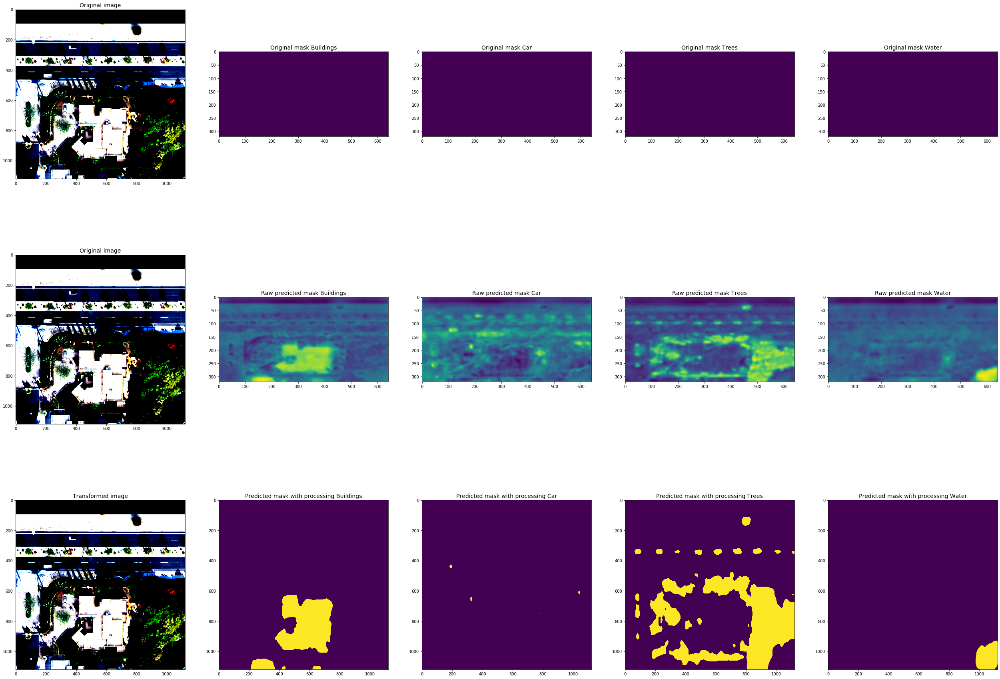

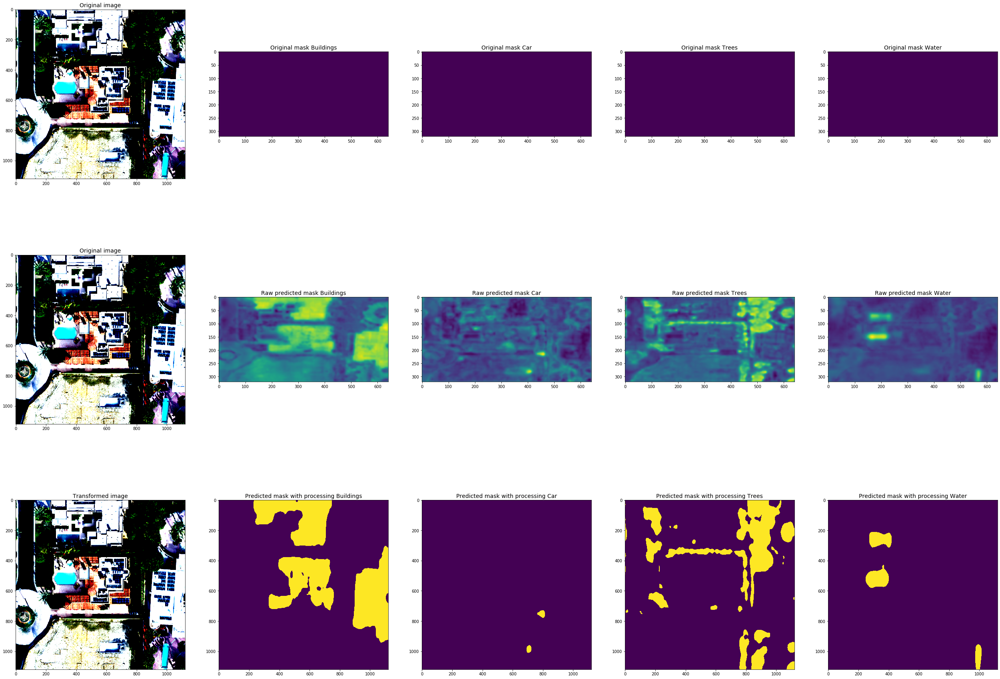

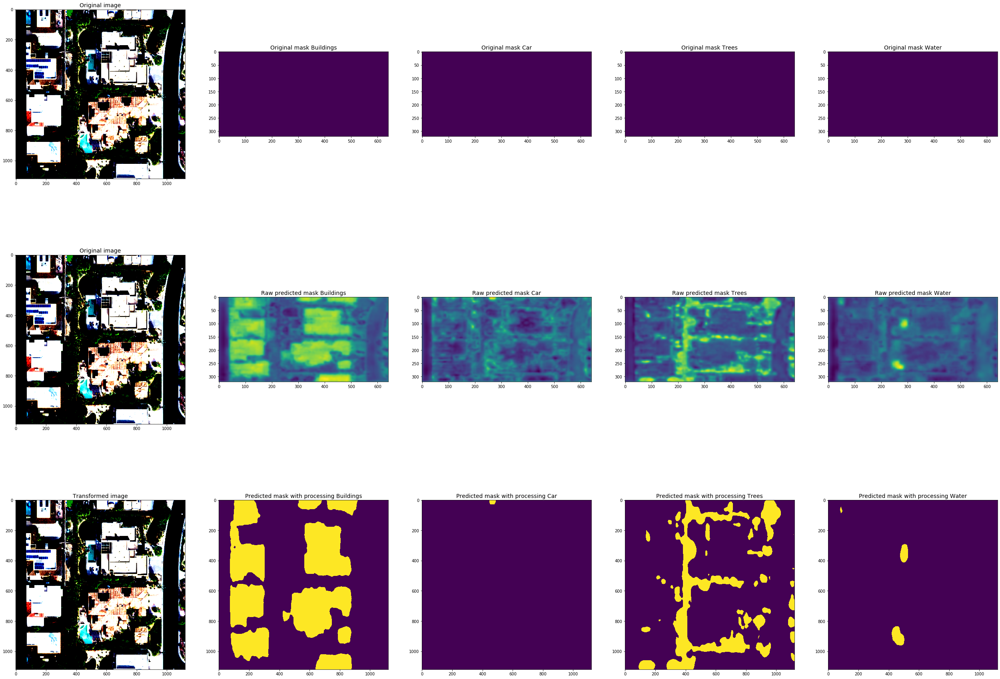

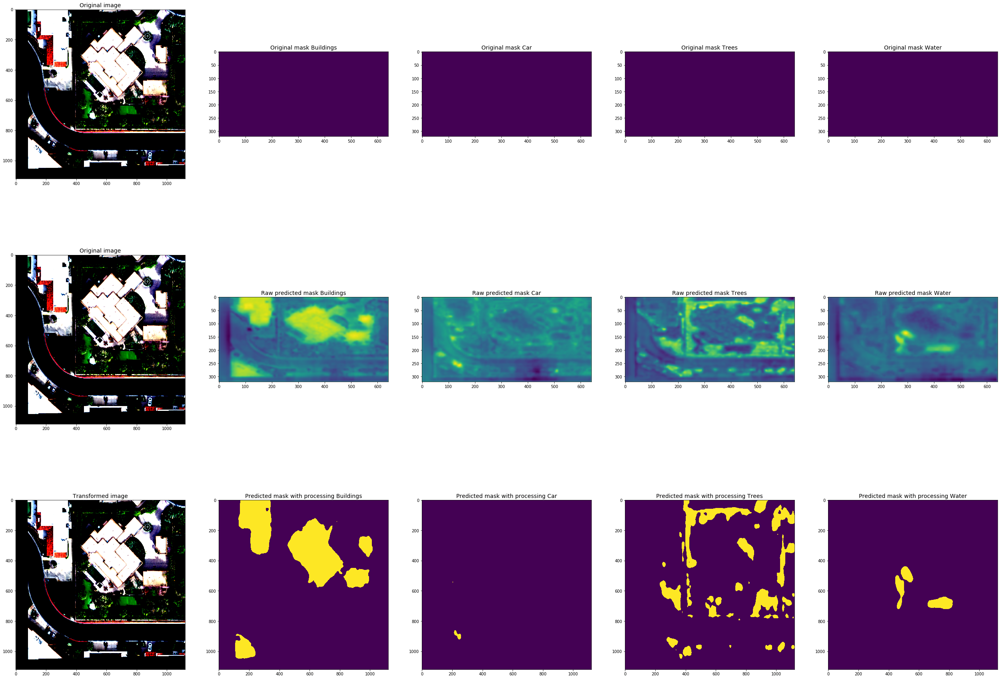

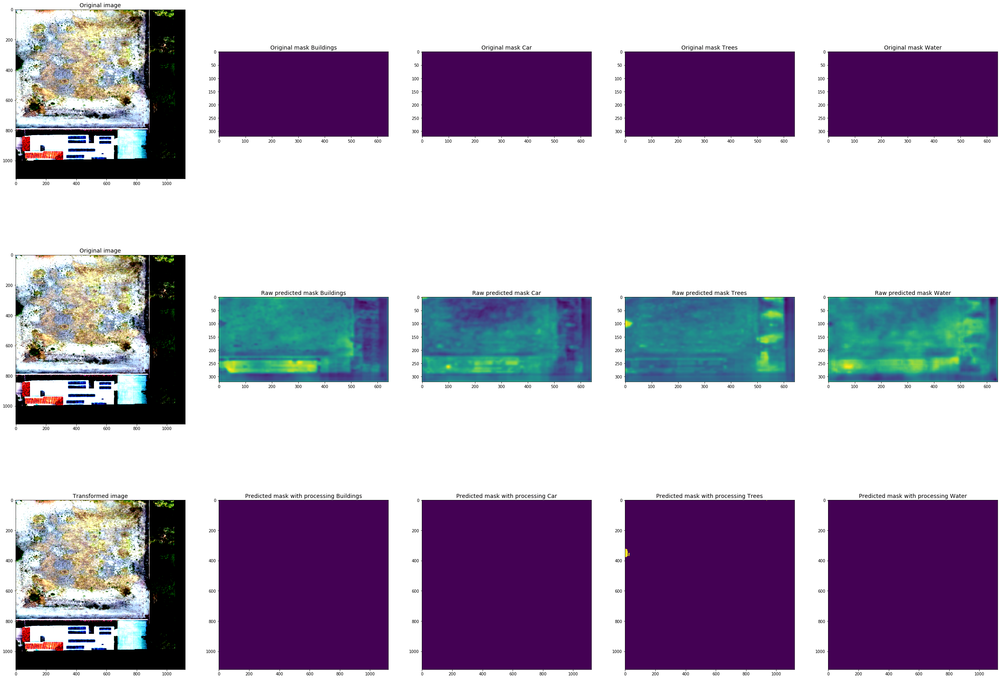

...

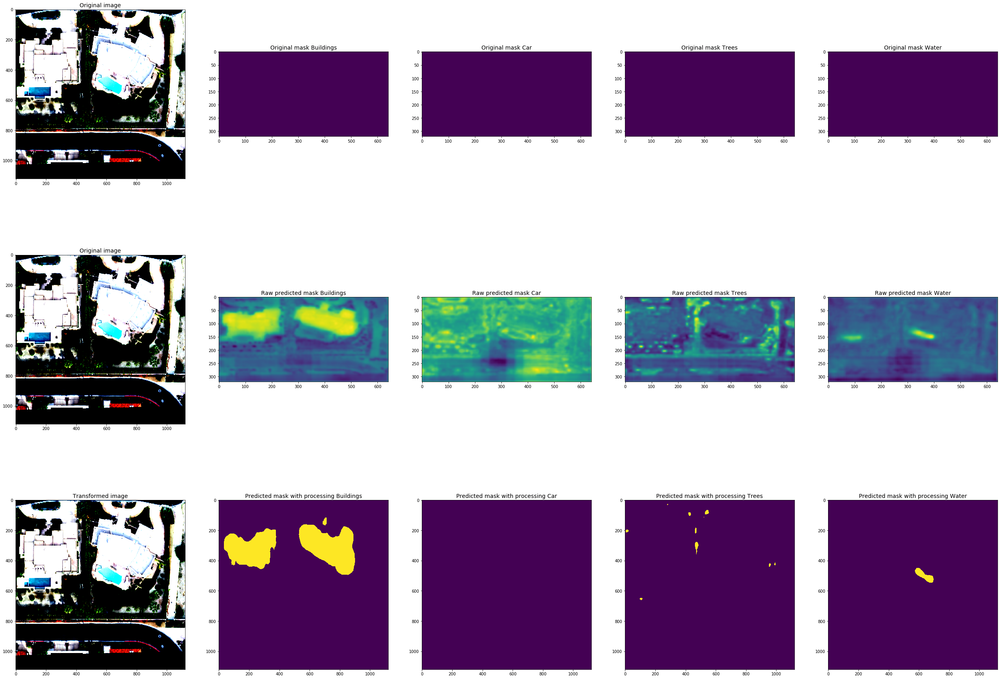

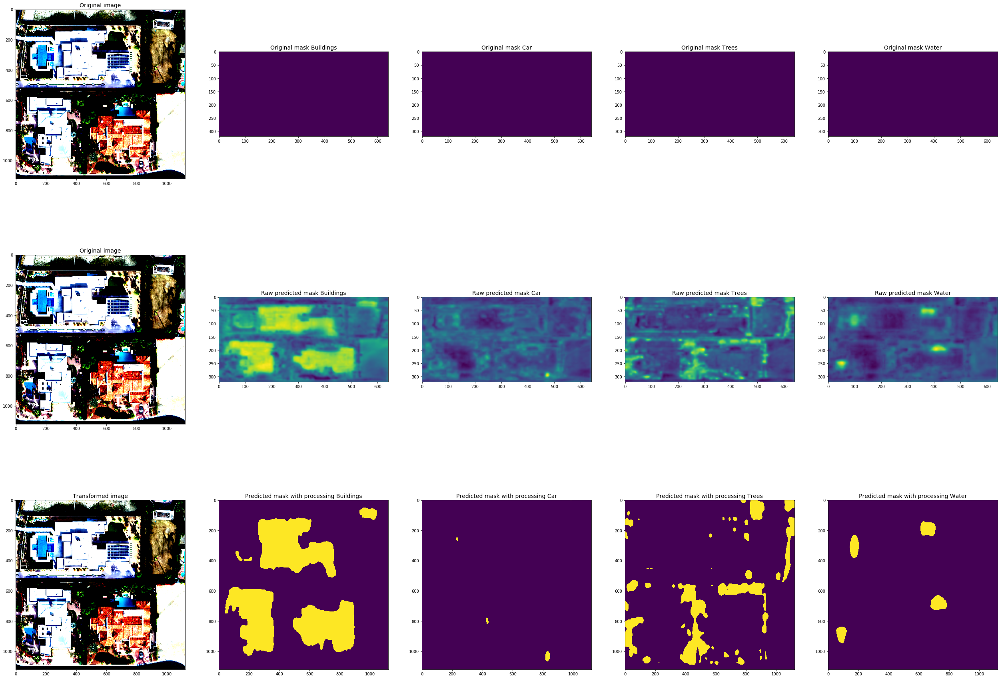

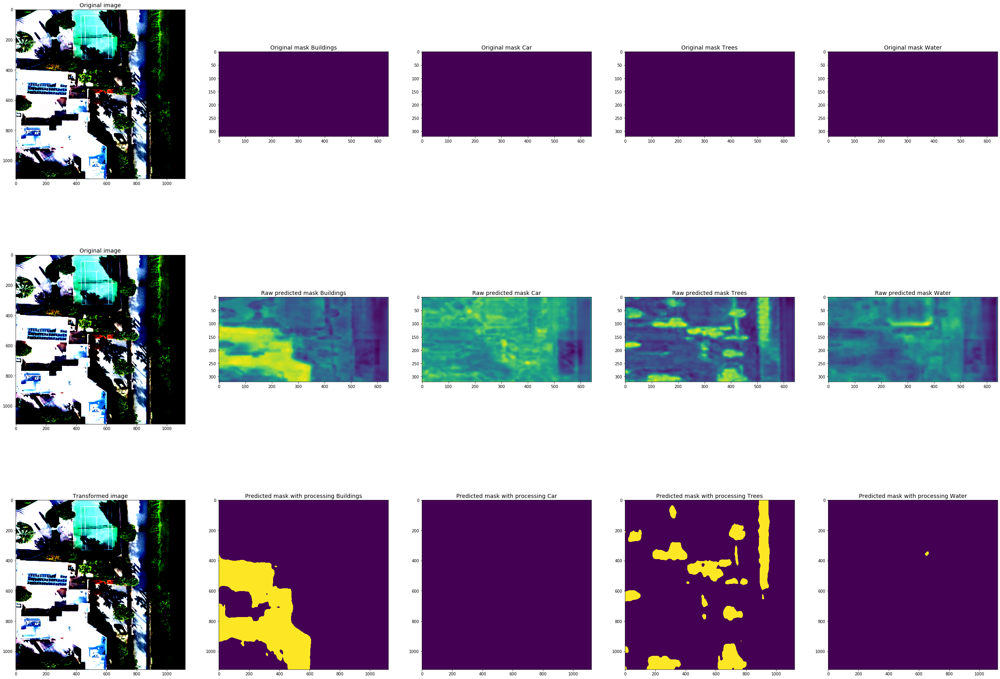

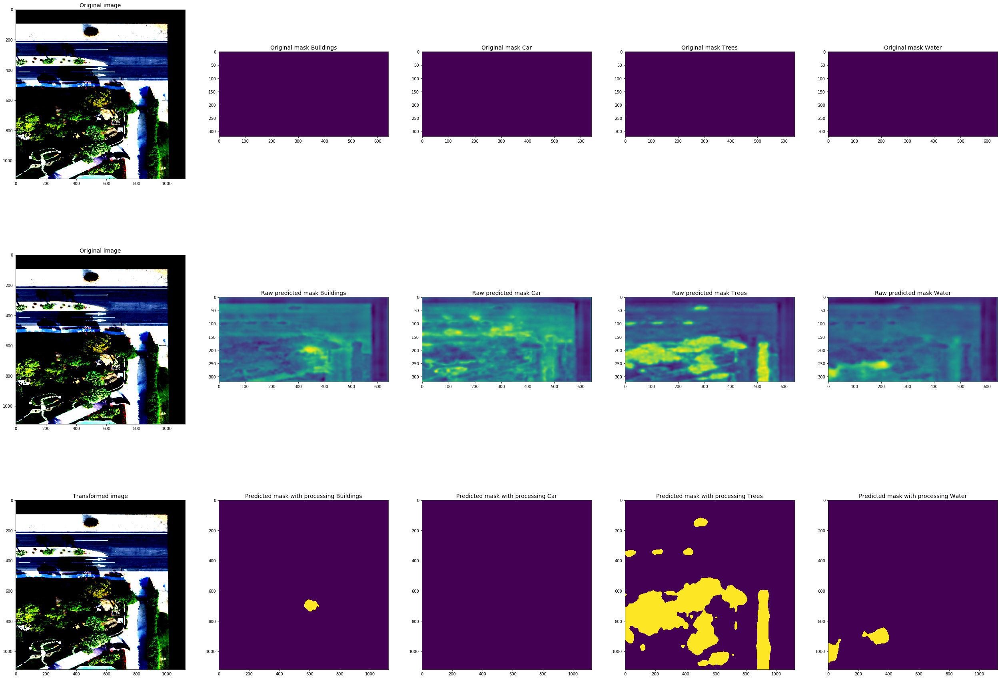

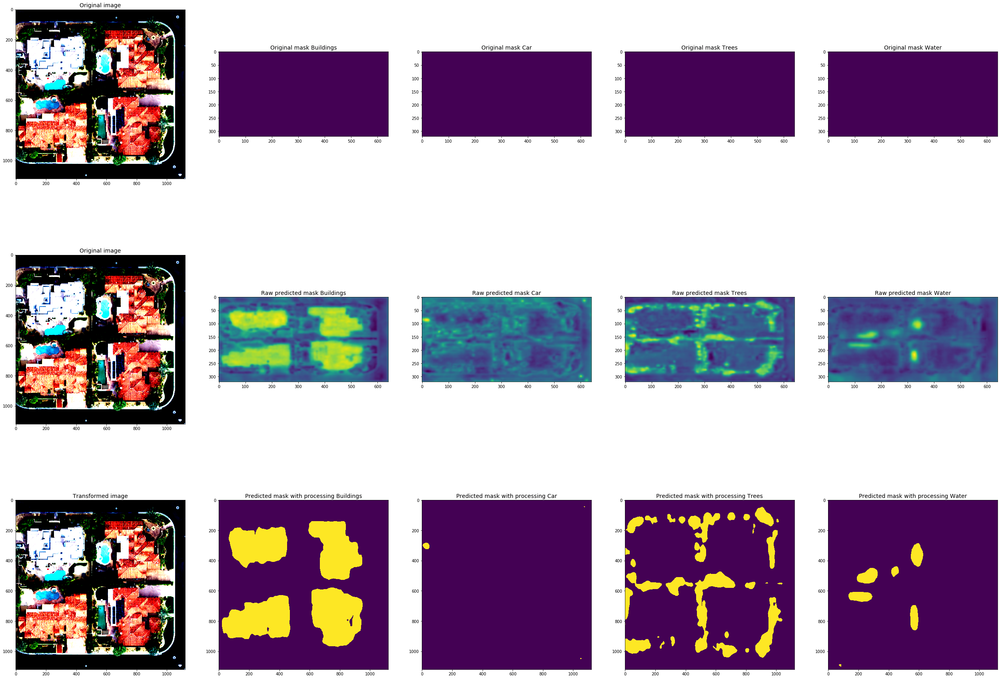

In [52]:
for i, (input, output) in enumerate(zip(
        test_dataset, predictions)):
    image, mask = input
        
    image_vis = image.transpose(1, 2, 0)
    mask = mask.astype('uint8').transpose(1, 2, 0)
    pr_mask = np.zeros((1120, 1120, 5))
    for j in range(4):
        probability = cv2.resize(output.transpose(1, 2, 0)[:, :, j], dsize=(1120, 1120), interpolation=cv2.INTER_LINEAR)
        pr_mask[:, :, j], _ = post_process(sigmoid(probability), class_params[j][0], class_params[j][1])
    #pr_mask = (sigmoid(output) > best_threshold).astype('uint8').transpose(1, 2, 0)
    masks.append(pr_mask)
    image_vis = cv2.resize(image_vis, (1120,1120))   
    visualize_with_raw(image=image_vis, mask=pr_mask, original_image=image_vis, original_mask=mask, raw_image=image_vis, raw_mask=output.transpose(1, 2, 0))
    
    if i >= 16:
        break

In [81]:
def get_mask(image,mask):
    mask[np.where(image == 1)[0],np.where(image==1)[1]] = [75, 25, 230]
    mask[np.where(image != 1)[0],np.where(image!=1)[1]] = [0, 255, 0]
    return(mask)

In [82]:
LABELMAP = {
    'Buildings' : [230,   25, 75], # Buildings
     'Car' : [0, 130,   200], # car
    #'Ground' : [0, 255, 0], # Ground 
    'Trees' : [60,  180,  75], # Trees
    'Water' : [245,  130, 48] # Water
   
}

INVLABELMAP = {
    '[230, 25, 75]' : 'Buildings', # Buildings
    '[0, 130, 200]' : 'Car', # car
    #'[0, 255, 0]' : 'Ground', # Ground 
    '[60, 180, 75]' : 'Trees', # Trees
    '[245, 130, 48]' : 'Water' # Water
    
}
    
label_dict = list(LABELMAP.values())

In [84]:
ret = np.full((1120,1120,3), [255, 255, 255])

In [88]:
for i,color in enumerate(label_dict):
    ret[np.where(masks[7][:,:,i] == 1)[0],np.where(masks[7][:,:,i]==1)[1]] = color

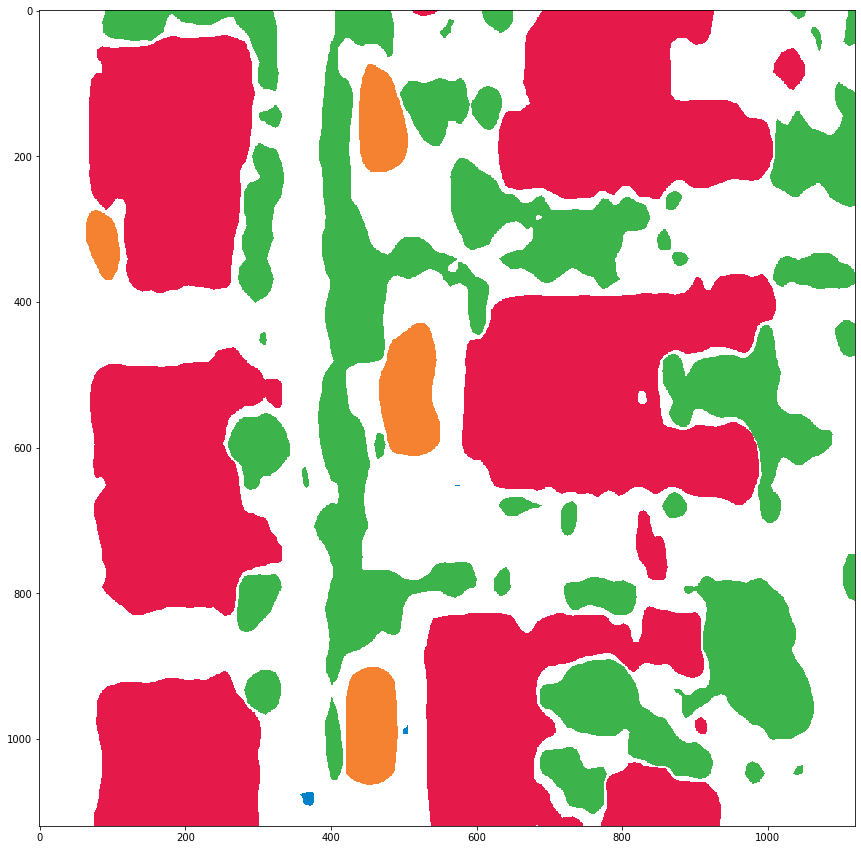

In [89]:
plt.rcParams["figure.figsize"] = (15,15)
plt.imshow(ret)

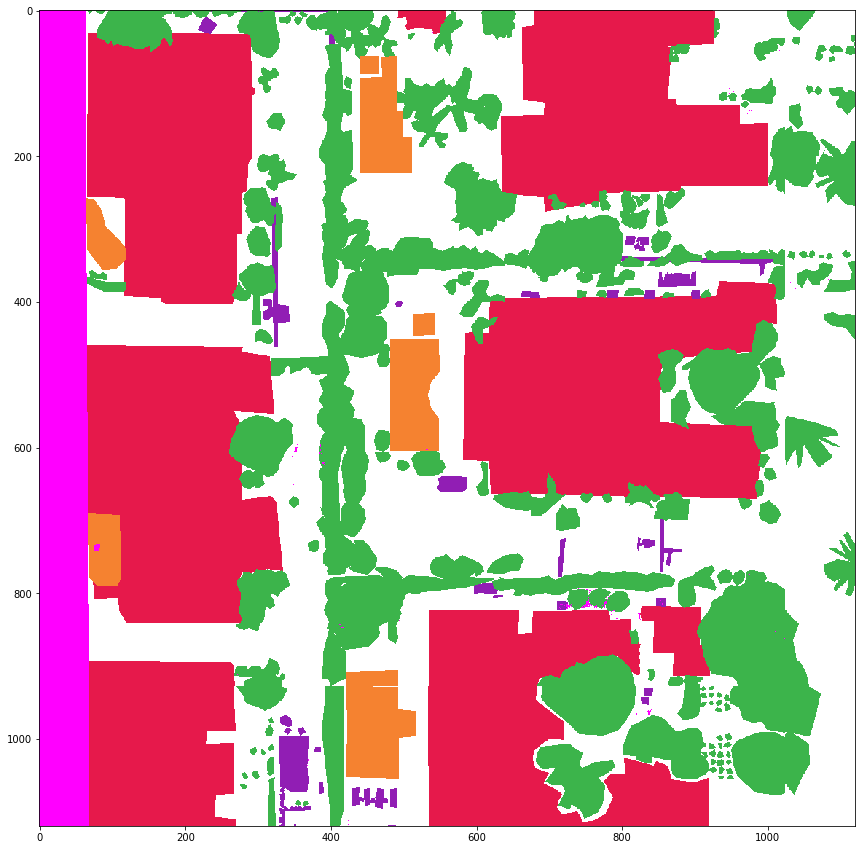

In [95]:
mask_1 = cv2.imread('PATH TO DATASET/label_train/1d4fbe33f3_F1BE1D4184INSPIRE-ortho-000001.png')
mask_1 = cv2.cvtColor(mask_1, cv2.COLOR_BGR2RGB) 
plt.imshow(mask_1)

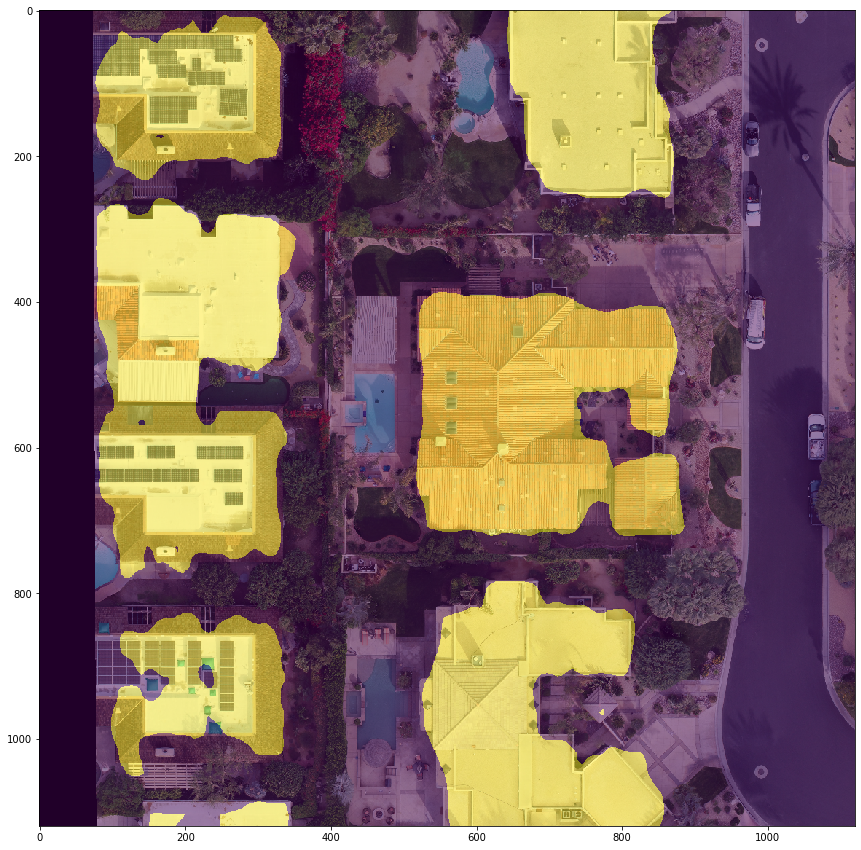

In [102]:
im_1 = cv2.imread('PATH TO DATA/image_train/1d4fbe33f3_F1BE1D4184INSPIRE-ortho-000003.png')
im_1 = cv2.cvtColor(im_1, cv2.COLOR_BGR2RGB) 
plt.imshow(im_1)
plt.imshow(masks[9][:,:,0],alpha = 0.5)